In [1]:
import json
import base64

# Load from a JSON file
with open("logos_dict.json", "r") as json_file:
    loaded_encoded_logos_dict = json.load(json_file)

# Decode the image data back to binary
decoded_logos_dict = {domain: base64.b64decode(img_bytes) for domain, img_bytes in loaded_encoded_logos_dict.items()}

In [2]:
from PIL import Image
import io

# Function to check if the binary data is a valid image
def is_valid_image(img_bytes):
    try:
        # Try to open the binary data as an image
        img = Image.open(io.BytesIO(img_bytes))
        img.verify()  # Verify the image file integrity
        return True
    except Exception:
        return False

# Filter decoded_logos_dict to keep only valid images
filtered_logos_dict = {
    domain: img_bytes
    for domain, img_bytes in decoded_logos_dict.items()
    if img_bytes is not None and is_valid_image(img_bytes)
}

print(f"Prior total number of logos: {len(decoded_logos_dict)}")
print(f"Number of filtered logos: {len(filtered_logos_dict)}")

Prior total number of logos: 3360
Number of filtered logos: 3336


In [8]:
from collections import defaultdict

# Grouping logic
grouped_logos = defaultdict(list)

for domain, img_bytes in filtered_logos_dict.items():
    key = domain[:4]  # First 4 letters of the domain
    grouped_logos[key].append((domain, img_bytes))

# Convert the defaultdict to a list of lists
result = [group for group in grouped_logos.values()]

print(f"Number of groups: {len(result)}")

Number of groups: 756


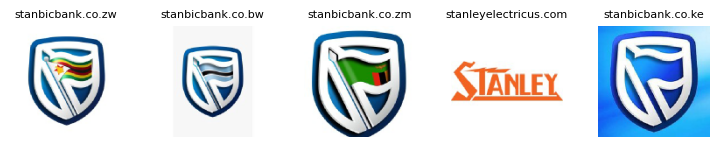

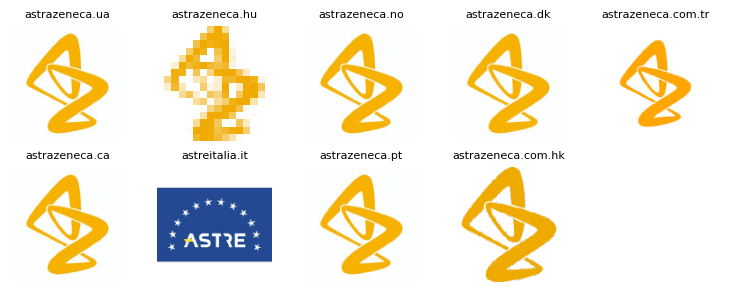

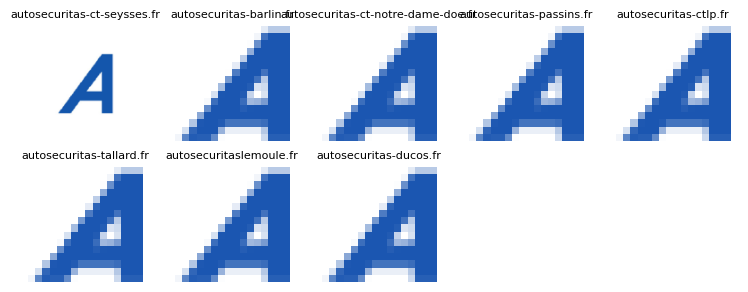

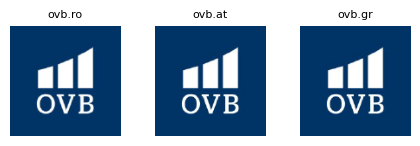

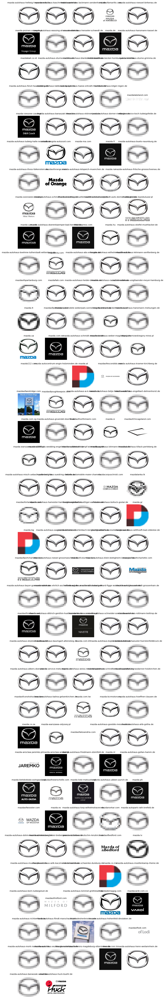

...

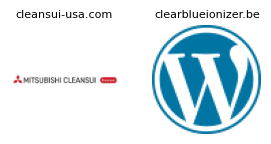

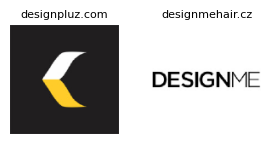

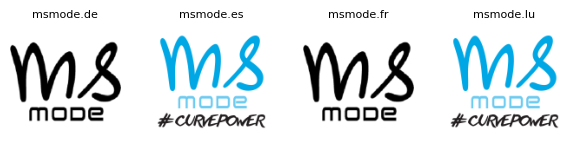

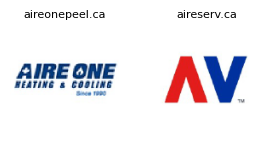

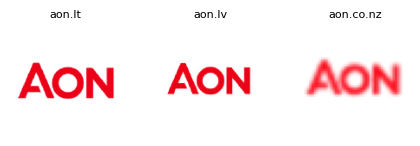

In [10]:
import matplotlib.pyplot as plt
from PIL import Image
import io
import math

# Function to convert image bytes to a PIL image
def bytes_to_image(img_bytes):
    return Image.open(io.BytesIO(img_bytes))

# Filter results with at least 2 domains
filtered_clusters = [domains for domains in result if len(domains) >= 2]

# Loop through groups to display images dynamically
for domains in filtered_clusters:
    num_images = len(domains)
    
    # Dynamically calculate rows and columns for the grid layout
    cols = min(5, num_images)  # Limit the number of columns to 5 for readability
    rows = math.ceil(num_images / cols)  # Calculate the required rows
    
    # Adjust figure size dynamically
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 1.5, rows * 1.5))  # Adjust size per image
    axes = axes.ravel() if num_images > 1 else [axes]  # Flatten axes if needed

    for i, (domain, img_bytes) in enumerate(domains):
        if domain in filtered_logos_dict:  # Check if the domain exists in the dictionary
            img = bytes_to_image(filtered_logos_dict[domain])  # Convert image bytes to PIL image
            axes[i].imshow(img)
            axes[i].set_title(domain, fontsize=8)
            axes[i].axis('off')  # Turn off axes
        else:
            print(f"Warning: Domain '{domain}' not found in filtered_logos_dict")

    # Turn off unused axes if fewer images than grid spaces
    for j in range(len(domains), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()